# 16-14. 프로젝트 : SRGAN 활용하기

## 목차
---
### 프로젝트 1, 2 : 직접 고른 이미지로 SRGAN 실험하기

- 프로젝트 1-1  
- 프로젝트 1-2

### 프로젝트 2 : SRGAN을 이용해 고해상도 gif 생성하기

- 1. gif 파일 불러오기  
- 2. 프레임별 Super Resolution 진행하기  
- 3. 프레임을 합쳐 gif 만들기  
- 4. Jupyter notebook에 gif 표시하기  

### 루브릭 & 회고

- 루브릭
- 회고

## 프로젝트 1 : 직접 고른 이미지로 SRGAN 실험하기
---

### 프로젝트 1-1.

1. (적당히) 높은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.
2. 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 1/4로 줄입니다. cv2.resize()를 사용해 봅시다.
3. 줄인 저해상도 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.
4. 2.의 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. 마찬가지로 cv2.resize()를 사용해 봅시다.
5. 3개 이미지(4.의 Bicubic의 결과, 3.의 SRGAN의 결과, 1.의 원래 고해상도 이미지)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.
6. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명해 봅시다. (정답은 없습니다)

## 0. 필요한 모듈 import

In [49]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_datasets as tfds

## 프로젝트 1-1. 고해상도 이미지로 SRGAN 실험하기

### 1. (적당히) 높은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.

(1440, 960, 3)


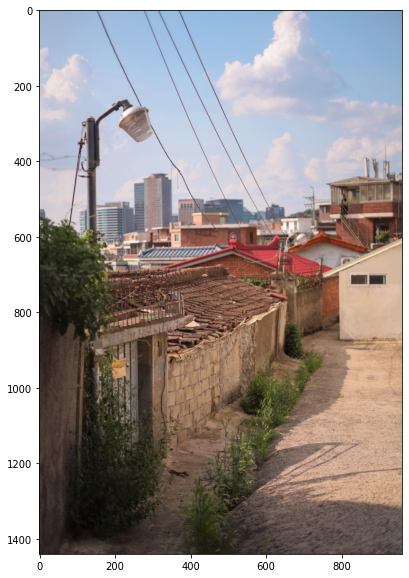

In [50]:
# 고해상도 이미지 불러오기
hr_image = cv2.imread(os.getenv('HOME') + '/aiffel/super_resolution/image/image01.jpeg')
hr_image = cv2.cvtColor(hr_image, cv2.COLOR_BGR2RGB)

# 이미지의 크기를 출력합니다.
print(hr_image.shape)

plt.figure(figsize=(20,10))
plt.imshow(hr_image)

출력 된 이미지의 크기는 (세로 픽셀수 x 가로 픽셀수 x 채널수) = (1440, 960, 3)으로 확인 할 수 있습니다.

위의 이미지는 본인이 2,620만 화소를 가진 카메라로 촬영한 후 색감 보정을 진행한 (적당한) 고해상도 이미지 입니다.

### 2. 불러온 이미지에 bicubic interpolation을 적용

위의 이미지를 cv2.resize()를 사용해서 가로 및 세로 픽셀 수를 1/4로 줄입니다.

참고로, dsize의 설정값에 따라 크기를 조절하는데, 주의할 점은

변환하고자 하는 이미지의 크기를 (가로 픽셀 수, 세로 픽셀 수) 로 지정해줘야 한다는 것입니다.

(360, 240, 3)


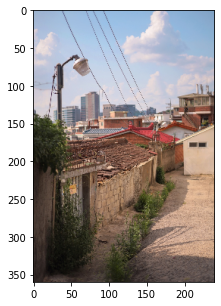

In [57]:
# 이미지 픽셀 수 줄이기 (1/4)
lr_image = cv2.resize(
    hr_image,
    dsize=(hr_image.shape[1]//4, hr_image.shape[0]//4),  # (가로 픽셀 수, 세로 픽셀 수)
    interpolation=cv2.INTER_CUBIC)  # bicubic interpolation 적용

print(lr_image.shape)

plt.figure(figsize=(10,5))
plt.imshow(lr_image)

위에서 본 (1440, 960, 3) 의 높은 해상도의 이미지가 (360, 240, 3)로 해상도가 1/4화 됨을 확인 할 수 있습니다.

### 3. 줄인 저해상도 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성

프로젝트 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.

우선, 프로젝트를 진행을 원활하게 하기 위해서 앞에서 학습이 완료된 Generator 파일인 srgan_G.h5 모델을 불러옵니다.

cf) SRGAN은 크게 두 개의 신경망(Generator, Discriminator)으로 구성되어 있지만, 테스트에는 저해상도 입력을 넣어 고해상도 이미지를 출력하는 Generator만 이용합니다.

In [58]:
# pre-trained 모델 로드
model_file = os.getenv('HOME')+'/aiffel/super_resolution/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

아래 코드와 같이 테스트 과정을 진행하는 함수를 간단하게 정의하고,

이 함수를 이용해 이전에 사용했던 이미지에 대해 SRGAN의 고해상도 결과를 생성합니다.

In [59]:
# SRGAN으로 고해상도 이미지 생성
def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)  # 텐서 값을 지정된 최소값과 최대값으로 자릅니다.
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

train, valid = tfds.load(
    "div2k/bicubic_x4", 
    split=["train","validation"],
    as_supervised=True      # as_supervised=True 옵션을 주면 dict 형태가 아닌 tuple 형태로 데이터를 return 받습니다.
)

for i, (lr, hr) in enumerate(valid):
    if i == 6: break

srgan_hr = apply_srgan(lr_image)

### 4. 2.의 이미지에 bicubic interpolation 적용

이미지의 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. 마찬가지로 cv2.resize()를 사용해 봅시다.

In [60]:
# bicubic interpolation으로 이미지 사이즈 키우기
bicubic_hr = cv2.resize(
    lr_image, 
    dsize=(hr_image.shape[1], hr_image.shape[0]), # 고해상도 이미지 크기로 설정
    interpolation=cv2.INTER_CUBIC # bicubic 설정
)

### 5. 3개 이미지(위에서 확인한 4.의 Bicubic의 결과, 3.의 SRGAN의 결과, 1.의 원래 고해상도 이미지)를 나란히 시각화

각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.

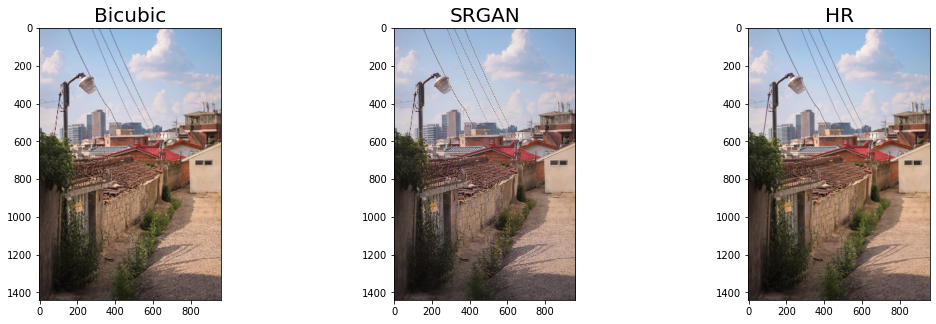

In [61]:
# 시각화
images = [bicubic_hr, srgan_hr, hr_image]
titles = ["Bicubic", "SRGAN", "HR"]

plt.figure(figsize=(18,5))
for i, (image, title) in enumerate(zip(images, titles)):
    plt.subplot(1,3,i+1)
    plt.imshow(image)
    plt.title(title, fontsize=20)

### 정리

(1) bicubic_hr: bicubic interpolation 이용하여 원본 이미지를 1/4로 줄였다가 원래 크기로 복원한 이미지

(2) srgan_hr: 1/4 크기로 줄인 bicubic_image에 srgan을 시행한 이미지

(3) hr_image: 원본 이미지

(1) ~ (3) 총 3장의 사진을 단순히 시각화를 한 것으로는 비교가 불가능 하니, 아래의 단계로 내려가 보도록 하겠습니다.

### 6. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution 평가하기

위의 이미지 3가지를 가지고 비교를 진행해보도록 하겠습니다.

#### 6-1. PSNR과 SSIM 비교

PSNR(Peak Signal-to-Noise Ratio)은 영상 내 신호가 가질 수 있는 최대 신호에 대한 잡음(noise)의 비율을 나타냅니다. 일반적으로 영상을 압축했을 때 화질이 얼마나 손실되었는지 평가하는 목적으로 사용됩니다. 데시벨(db) 단위를 사용하며, PSNR 수치가 높을수록 원본 영상에 비해 손실이 적다는 의미입니다 (값이 높을수록 좋습니다).

SSIM(Structural Similarity Index Map)은 영상의 구조 정보를 고려하여 얼마나 구조 정보를 변화시키지 않았는지를 계산합니다. 특정 영상에 대한 SSIM값이 높을수록 원본 영상의 품질에 가깝다는 의미입니다 (마찬가지로 값이 높을수록 좋습니다).

이번 학습에서는 위와 같은 정량적 평가 척도에 대해 자세히 다루지는 않습니다. PSNR과 SSIM 결과가 높을수록 비교하려는 영상이 원본 영상 품질에 가깝다는 사실만 알고 넘어가셔도 되며, 이에 대해 자세히 이해하고자 하신다면 아래 참고 자료를 읽어 보시길 바랍니다.

- 참고 자료: 최대신호대잡음비(PSNR)와 이미지 품질 (https://bskyvision.com/392)

- 참고 자료: 2D 이미지 품질 평가에 구조변화를 반영하는 SSIM과 그의 변형들 (https://bskyvision.com/396)

PSNR과 SSIM은 scikit-image 라이브러리를 이용해 쉽게 계산할 수 있습니다.

위의 내용을 정리해보자면, PSNR과 SSIM 모두 높은 값을 가질수록 원본 이미지와 가깝다는 것을 의미하며, PSNR은 상한값이 없고, SSIM은 0~1 사이의 값을 가집니다.

In [62]:
from skimage.metrics import peak_signal_noise_ratio, structural_similarity

print("**bicubic_hr,hr_image 이미지 비교**")
print("PSNR :", peak_signal_noise_ratio(bicubic_hr,hr_image))
print("SSIM :", structural_similarity(bicubic_hr,hr_image, multichannel=True))

**bicubic_hr,hr_image 이미지 비교**
PSNR : 27.120079725904223
SSIM : 0.8007219111411703


In [63]:
print("**srgan_hr, hr_image 이미지 비교**")
print("PSNR :", peak_signal_noise_ratio(srgan_hr, hr_image))
print("SSIM :", structural_similarity(srgan_hr, hr_image, multichannel=True))

**srgan_hr, hr_image 이미지 비교**
PSNR : 21.60221735850194
SSIM : 0.5759483304653172


PSNR과 SSIM 비교 결과,

bicubic_hr이  srgan_hr보다 원본 이미지와 가깝다는 것을 알 수 있었습니다.

그렇다면, 이번에는 이미지의 특정 부분을 crop해서 3개의 이미지를 비교해 보겠습니다.

#### 6-2. 특정 영역 crop 후 주관적 판단으로 비교

In [64]:
# 특정 영역을 잘라낼 함수를 정의합니다.
def crop(image, left_top, x=50, y=100):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]

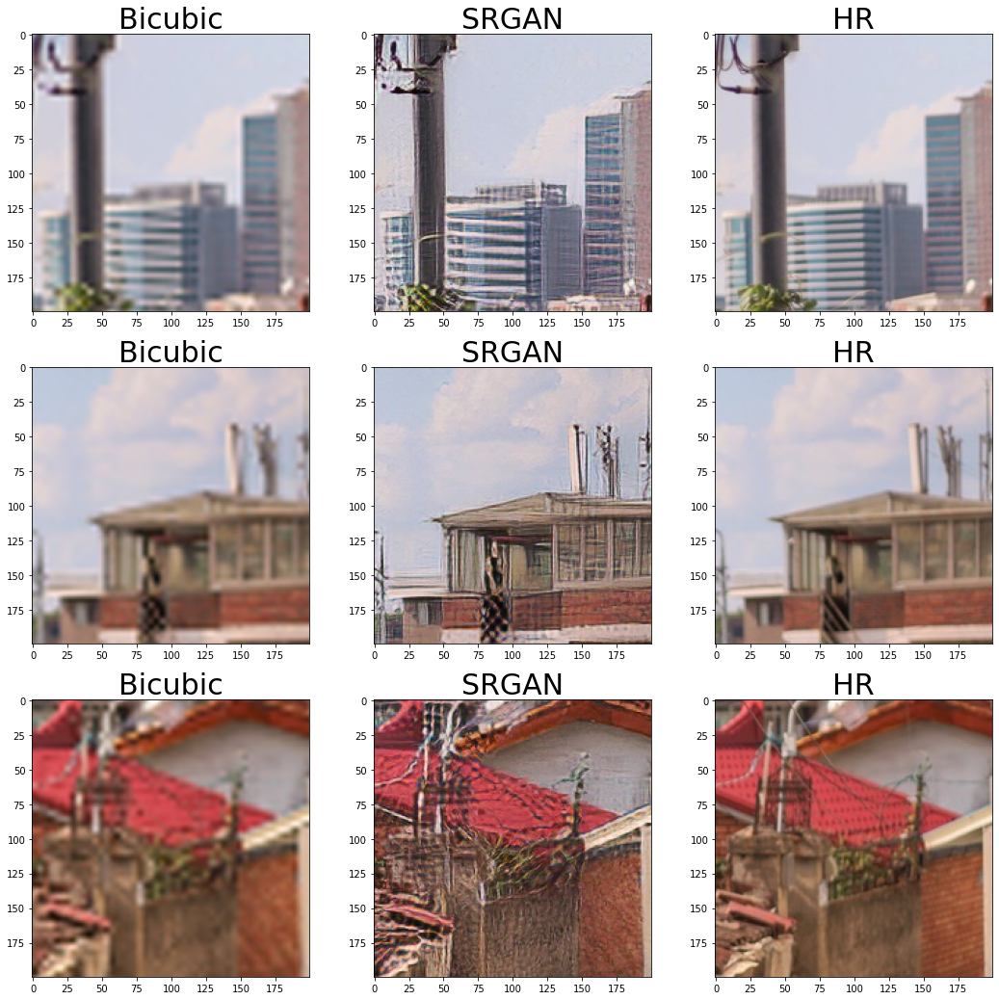

In [65]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(400,100), (350,720), (600,600)]

images = []
for left_top in left_tops:
    img1 = crop(bicubic_hr, left_top, 200, 200)
    img2 = crop(srgan_hr , left_top, 200, 200)
    img3 = crop(hr_image, left_top, 200, 200)
    images.extend([img1, img2, img3])

labels = ["Bicubic", "SRGAN", "HR"] * 3

plt.figure(figsize=(18,18))
for i in range(9):
    plt.subplot(3,3,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

앞에서 보았던 PSNR과 SSIM 비교 결과와는 다르게,

원본을 기준으로 crop한 이미지로 비교해보자면,

선명도 기준에선 SRGAN 이미지는 원본보다 선명한 이미지를 출력해주었으며, Bicubic 이미지는 원본과 유사하지만 약간 어색한 블러처리를 보여주었습니다.

GAN보다 개선 된 SRGAN 이기에 과거 프로젝트에서 진행한 GAN 보다는 선명한 이미지를 만들어주기는 하였으나, 노드의 말을 빌려서 적어보자면, '매우 선명하게 이상함' 이라는 표현이 정확하다는 생각을 할 수 있었습니다.

위의 내용을 정리해보자면 SRGAN의 이미지가 Bicubic보다 선명하고, 원본 HR 보다는 어딘가 어색함이 있었지만, 나름대로 잘 구현한 것 같습니다.

### 프로젝트 1-2.

1. (적당히) 낮은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.
2. 불러온 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.
3. 1.에서 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. cv2.resize()를 사용해 봅시다.
4. 2개 이미지(3.의 Bicubic의 결과, 2.의 SRGAN의 결과)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.
5. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명해 봅시다. (정답은 없습니다)

## 2. 저해상도 이미지로 SRGAN 실험하기

### 2-1. (적당히) 낮은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.

로컬 내에서 고해상도 이미지를 리사이즈 해서 해상도를 적당히 낮춘 이미지를 불러옵니다.

(600, 900, 3)


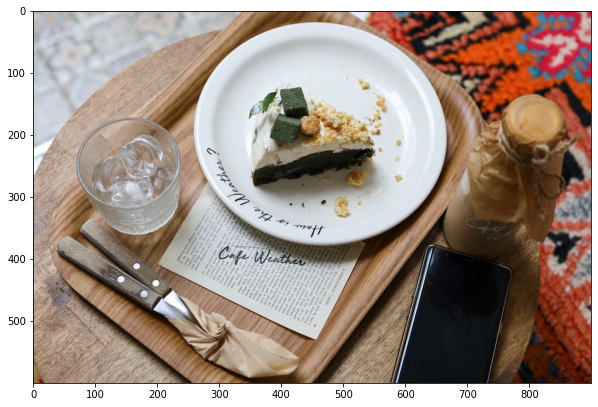

In [90]:
# 저해상도 이미지 불러오기
image = cv2.imread(os.getenv('HOME') + '/aiffel/super_resolution/image/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

print(image.shape)

plt.figure(figsize=(10,20))
plt.imshow(image)

적당히 낮은 해상도 (600, 900, 3)을 가진 이미지를 불러왔음을 확인 할 수 있습니다.

### 2. 불러온 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성

위에 정의한 테스트 과정을 진행하는 함수와 apply_srgan 함수를 사용해서 SRGAN의 고해상도 결과를 생성해보도록 하겠습니다.

In [91]:
# SRGAN으로 고해상도 이미지 생성
srgan_hr = apply_srgan(image)

### 3. 1.에서 불러온 이미지에 bicubic interpolation을 적용

bicubic interpolation을 적용해서 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. cv2.resize()를 사용해 봅시다.

In [92]:
# bicubic interpolation으로 이미지 사이즈 키우기
bicubic_hr = cv2.resize(
    image, 
    dsize=(image.shape[1]*4, image.shape[0]*4), # 고해상도 이미지 크기로 설정
    interpolation=cv2.INTER_CUBIC # bicubic 설정
)

### 4. 2개 이미지 (3.의 Bicubic의 결과, 2.의 SRGAN의 결과)를 나란히 시각화

각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.

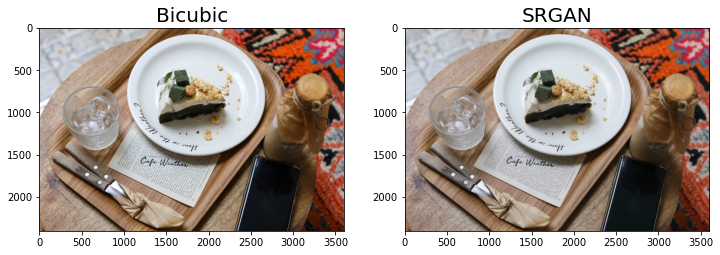

In [93]:
# 시각화
images = [bicubic_hr, srgan_hr]
titles = ["Bicubic", "SRGAN"]

plt.figure(figsize=(12,5))
for i, (image, title) in enumerate(zip(images, titles)):
    plt.subplot(1,2,i+1)
    plt.imshow(image)
    plt.title(title, fontsize=20)

### 정리

(1) bicubic_hr: bicubic interpolation 이용하여 image를 4배로 키운 이미지

(2) srgan_hr: image를 SRGAN으로 고해상도화 한 이미지

(1) ~ (2) 총 2장의 사진을 단순히 시각화를 한 것으로는 비교가 불가능 하니, 아래의 단계로 내려가 보도록 하겠습니다.

### 5. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution 평가하기

위의 이미지 2가지를 가지고 비교를 진행해보도록 하겠습니다.

#### 5-1. PSNR과 SSIM 비교

PSNR과 SSIM 모두 높은 값을 가질수록 원본 이미지와 가깝다는 것을 의미하며, PSNR은 상한값이 없고, SSIM은 0~1 사이의 값을 가집니다.

-> 비교할 원본 이미지가 없으므로, PSNR과 SSIM 비교를 진행할 수는 없습니다.

#### 5-2. 특정 영역 crop 후 주관적 판단으로 비교

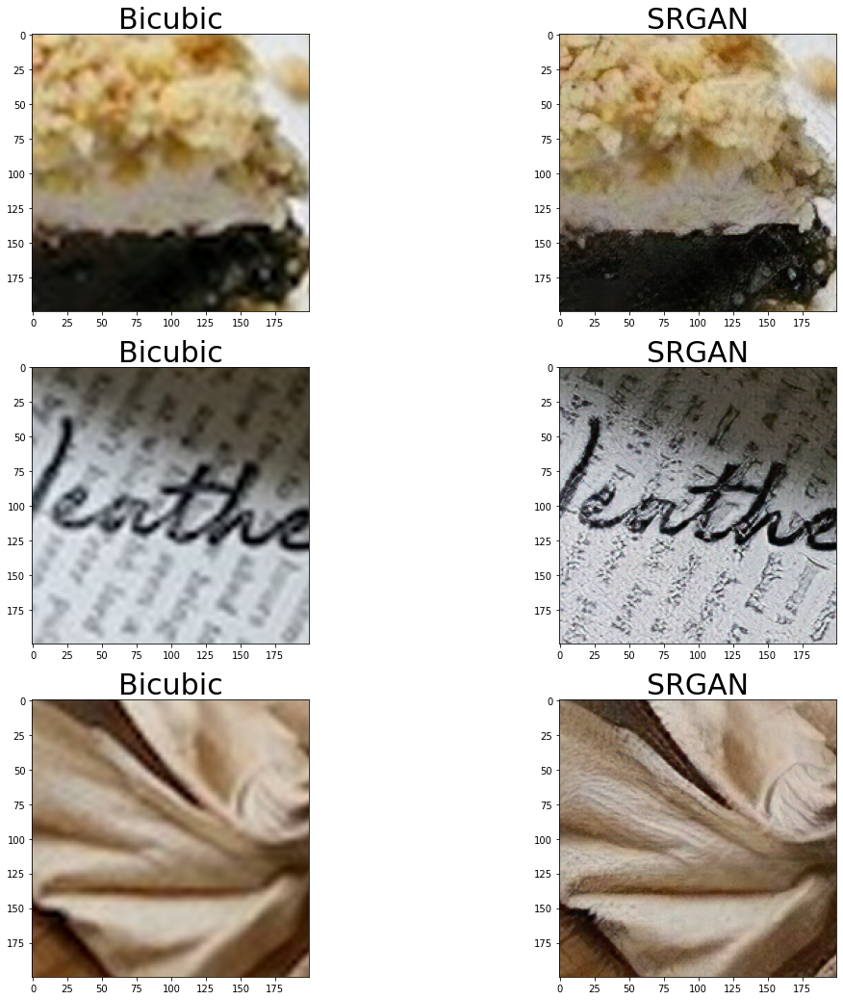

In [113]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(750,2000), (1500,1500), (2000,1000)]

images = []
for left_top in left_tops:
    img1 = crop(bicubic_hr, left_top, 200, 200)
    img2 = crop(srgan_hr , left_top, 200, 200)
    images.extend([img1, img2])

labels = ["Bicubic", "SRGAN"] * 3

plt.figure(figsize=(18,18))
for i in range(6):
    plt.subplot(3,2,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

특정 영역 crop 한 후 이미지를 비교해보니 원본 파일과 비교하기에는 애매하긴 하지만,

SRGAN 이미지가 Bicubic 이미지보다 훨씬 더 선명하게 이미지를 생성하였음을 확인 할 수 있었습니다.

### 프로젝트 2 : SRGAN을 이용해 고해상도 gif 생성하기
---
이전 Super Resolution의 활용 사례에 대해 살펴봤을 때, 단일 이미지가 아닌 영상에 대해 Super Resolution을 적용한 사례가 있었습니다. 이번에는 이미 학습된 SRGAN을 이용해 저해상도 영상을 고해상도 영상으로 바꿔보는 프로젝트를 수행해 봅시다.

실제로 동영상의 Super Resolution은 시간 순서에 따른 다수의 프레임 정보를 고려하는 것이 더 좋지만, 처음부터 학습시키기에 많은 시간이 소요됩니다. 여기서는 이전에 사용했던 SRGAN을 이용해 한 프레임씩 고해상도 이미지로 변환 시켜 모든 프레임에 대해 적용하고, 그 프레임들을 합쳐 동영상으로 만들어 봅시다.

각 프레임들을 모아 gif 파일을 만드는데 아래 라이브러리의 설치가 필요합니다.

- pip install imageio

### 1. gif 파일 불러오기
---
아래 주소에 몇 개의 gif 파일이 있습니다. 이 중 하나를 골라 다운 로드하여 아래 과정을 수행합시다. (한 개 이상의 gif 파일에 대해 아래 과정을 수행해야 합니다!)

GIF files https://drive.google.com/drive/folders/1OLsa4btdwNUiVJcOJgZe_C6-lwEoNr4e

다운받은 gif 파일을 아래와 같은 과정을 통해 각 프레임(이미지)을 불러올 수 있습니다. frames이란 리스트 안에 각각의 프레임이 들어 있습니다.

In [114]:
import cv2

# 다운받은 파일의 경로를 설정해 주세요.
gif = cv2.VideoCapture(os.getenv('HOME') + '/aiffel/super_resolution/gif/city_night_lr.gif')

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 8
frame 크기 : (255, 500, 3)


### 2. 프레임별 Super Resolution 진행하기
---
Bicubic interpolation과 SRGAN을 이용해 각각의 가로, 세로 픽셀 수를 4배로 늘려봅시다. Super Resolution이 완료된 각각의 결과를 frames_sr이라는 리스트에 넣어주세요.

In [115]:
# Bicubic interpolation을 이용해서 각각의 가로, 세로 픽셀 수를 4배 늘리기
# SR이 완료된 결과는 frame_sr 이라는 리스트에 넣어줍니다.

frames_sr_bicubic = []

for frame in frames:
    frames_sr_bicubic.append(cv2.resize(
        frame, 
        dsize=(frame.shape[1]*4, frame.shape[0]*4), # 고해상도 frame 크기로 설정
        interpolation=cv2.INTER_CUBIC # bicubic 설정
    ))

In [116]:
# SRGAN을 이용해서 각각의 가로, 세로 픽셀 수를 4배 늘리기
# SR이 완료된 결과는 frame_sr 이라는 리스트에 넣어줍니다.

frames_sr_srgan = []

for frame in frames:
    frames_sr_srgan.append(apply_srgan(frame))

### 3. 프레임을 합쳐 gif 만들기
---
위에서 frame_sr을 만들었다면 아래 코드와 같이 gif 파일을 생성할 수 있습니다. Bicubic 및 SRGAN의 결과를 각각 저장하여 2개 파일을 만들어 주세요.

In [118]:
import imageio

gif_dir = os.getenv('HOME') + '/aiffel/super_resolution/gif'

imageio.mimsave(os.path.join(gif_dir, 'city_night_hr_bicubic.gif'), frames_sr_bicubic)
imageio.mimsave(os.path.join(gif_dir, 'city_night_hr_srgan.gif'), frames_sr_srgan)

### 4. Jupyter notebook에 gif 표시하기
---
아래와 같이 다운받은 저해상도 gif 파일과 고해상도 gif 파일을 각각 jupyter 내에 출력하여 최종 제출해 주시면 됩니다.

jupyter 내에 출력이 어려운 경우, GitHub에 저해상도, 고해상도 gif파일을 업로드 후 링크를 첨부해주시기바랍니다.

Super Resolution이 잘 적용되었는지 시각적으로 확인하기 위해 아래의 width 옵션을 적당히 크게 해주세요.

저해상도 및 고해상도 시각화의 width 값은 같도록 설정해주세요.

비교 gif 'city_night_lr', 'city_night_hr_bicubic', 'city_night_hr_srgan' 총 3개의 gif 를 최종 출력해봅시다.

아래의 gif는 용량이 큰 관계로, 용량을 줄인 gif 를 올려보도록 하겠습니다.

In [122]:
# from IPython.display import Image as show_gif

# show_gif(os.path.join(gif_dir, 'city_night_lr.gif'), width=800)

In [123]:
# show_gif(os.path.join(gif_dir, 'city_night_hr_bicubic.gif'), width=800)

In [124]:
# show_gif(os.path.join(gif_dir, 'city_night_hr_srgan.gif'), width=800)

### 정리

(1) city_lr: 원본 저해상도 gif

(2) city_hr_bicubic: Bicubic interpolation을 이용해서 가로, 세로 픽셀 수를 4배 늘린 후, frame을 합친 gif

(3) city_hr_srgan: SRGAN을 이용해서 가로, 세로 픽셀 수를 4배 늘린 후, frame을 합친 gif

#### 위의 gif의 용량이 너무 커서... https://www.iloveimg.com/ 로 용량을 줄인 gif 를 첨부하였습니다.

(1) city_lr: 원본 저해상도 gif

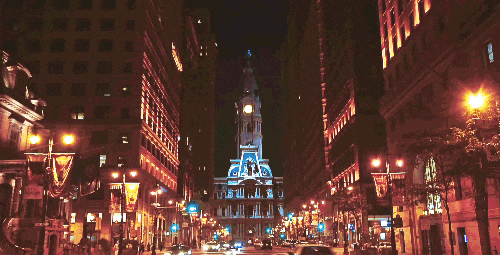

(2) city_hr_bicubic

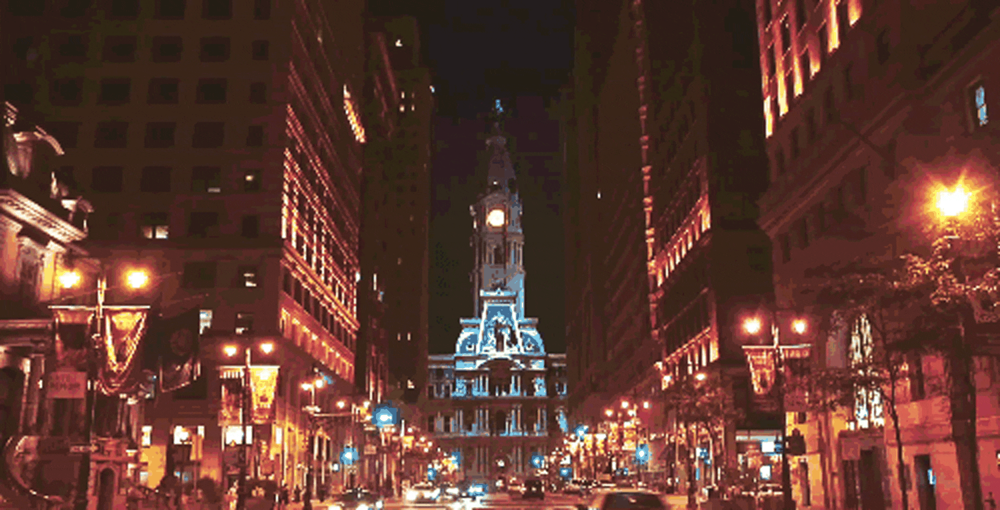

(3) city_hr_srgan

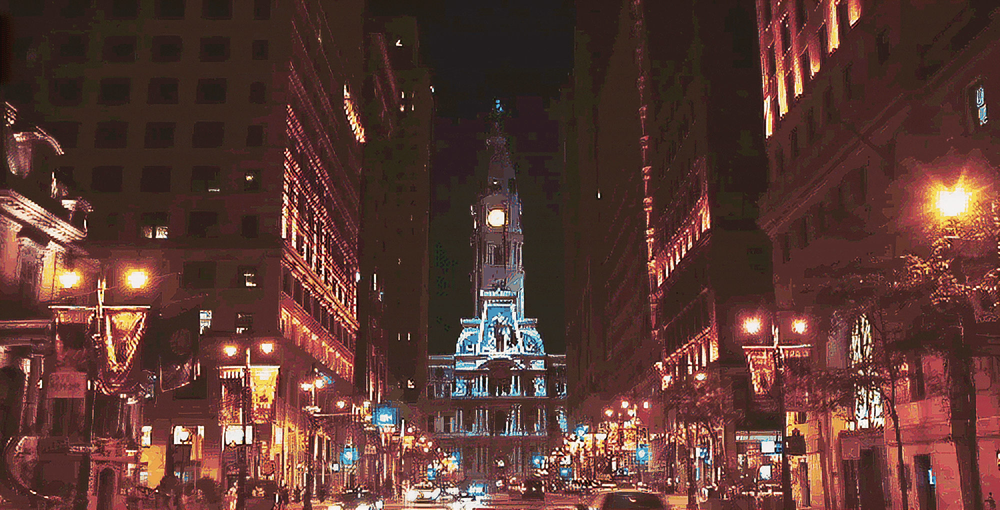

### 5. gif 영상을 Super Resolution한 결과 분석
---

저녁 영상이라 전체적으로 노이즈가 껴있어서 그런지는 모르겠지만,

고해상도의 영상에서 눈에 띄는 변화가 있다는 생각이 들지는 못한 결과가 나왔다고 생각합니다.

## 루브릭 & 회고

### 루브릭
---

1. SRGAN을 이용해 고해상도의 이미지를 생성하였다.

- SRGAN을 통해 생성된 이미지를 제출하였다.

2. 다양한 해상도의 이미지에 대해 시각화를 통해 원본, SRGAN생성본, interpolation생성본을 비교분석하였다.

- 이미지의 특성과 super resolution 방법을 관련지어 생성 결과를 체계적으로 분석하였다.

3. 저해상도 gif 동영상을 고해상도 동영상으로 성공적으로 변환하였다.

- 저해상도 원본 gif와 생성된 고해상도 gif의 해상도 차이가 시각적으로 확인 가능하다.

### 회고
---

- 나름대로 GAN을 열심히 공부했었다고 생각했었지만, 프로젝트 진행 전 이론에 대한 내용을 이해하는 과정에서 어려움을 많이 느꼈던 거 같습니다.

- 하지만, 모델을 생성 후, 그에 따른 결과를 바로바로 볼 수 있어 호기심을 자극했던 프로젝트였습니다.

- 이미지 출력과정에서 사용한 Bicubic는와 SRGAN을 비교해보자면,

- Bicubic는 픽셀 수를 4배 증가 시키면서 해상도를 크게 만든 것이라 전체적으로 블러가 쳐진 거처럼 뿌연 느낌의 이미지를 보여주었던 반면에, SRGAN은 고해상도의 이미지를 생성하다보니 지난 GAN으로 걱정했던 결과와는 다르게 전체적으로 선명한 이미지를 생성해서 신기했습니다.

- 지난 번에 진행했었던 GAN은 '이게 이미지가 맞나??' 라는 생각을 자주 했었고, 저의 의견을 퍼실님이나 스터디원들과 공유 했을 때 공통적으로 나왔던 '마음의 눈으로 보아야 알아볼 수 있는 이미지'를 출력해 주어서 CV에 지원한 것에 대한 걱정과 우려가 있었는데, 이번에 SRGAN을 사용해서 프로젝트를 진행해보면서 CV 분야에 지원하길 잘 했다는 생각합니다.

- 하지만, 이미지와는 다르게 영상 영역에선 눈에 띄는 결과를 내지 못 해서 아쉬웠습니다.

- 앞으로 Going Deeper에서 열심히 공부해서 영상 영역에서도 눈에 띄는 결과를 만들어 낼 수 있는 이론을 배워보고 싶다는 생각을 하게 만드는 프로젝트였다고 생각합니다.

- gif 파일이 너무 커서 업로드 못 하고 있을 때, gif 용량을 줄이는 방법 (https://m.blog.naver.com/meyouhappy/221959819728)을 알려주신 성연님에게 무한한 감사를 드립니다.

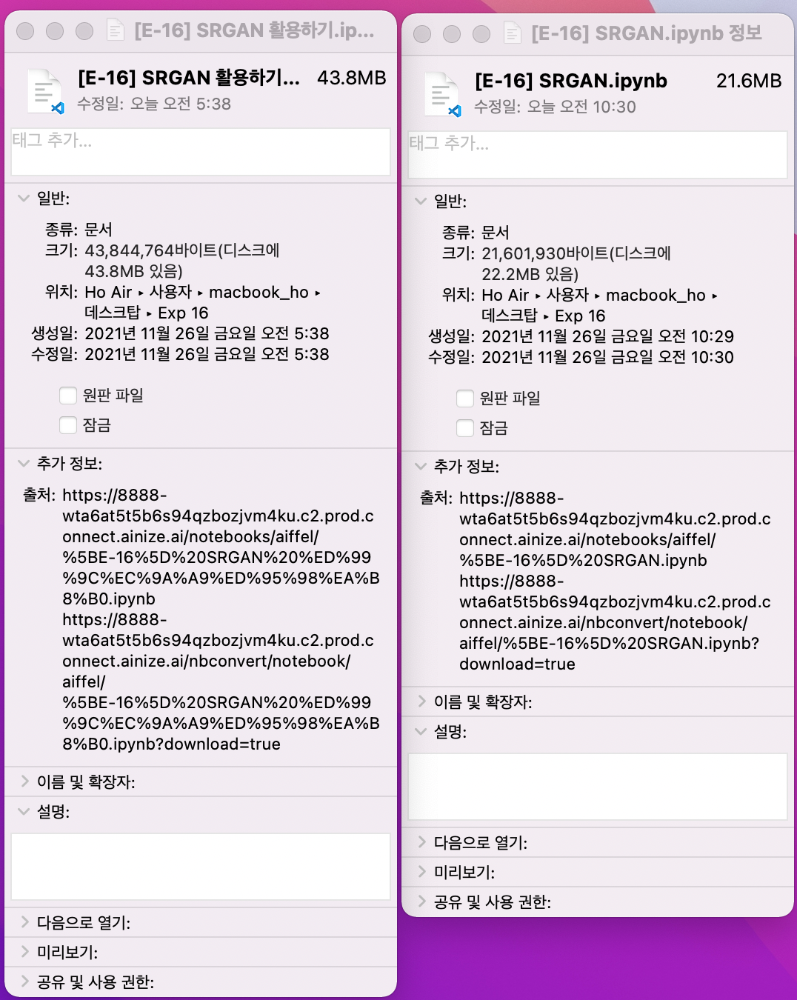

(좌) 원본 gif 로 이미지를 넣었 때 43.8mb, (우) gif 용량을 줄인 후, 넣었을 때 22.2 mb -> 위 이미지를 넣고 나니 23.1mb 가 되었습니다 ㅠ